<a href="https://colab.research.google.com/github/RubenMcCarty/Deep-Learning-RQ/blob/main/gol_Juego_Vida.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# El Juego de la Vida (en 3 niveles de programación)
[MSc. Ruben Quispe](https://www.linkedin.com/in/ruben-quispe-l/)

El **juego de la vida** es un programa simple muy útil para aprender y asentar conceptos básicos de programación necesarios para llevar a cabo tareas más complejas. Introducido por el matemático John Horton Conway en 1970, se trata de un **autómata celular**, un mecanismo simplificado que imita un sistema biológico evolucionando en el tiempo siguiendo unas reglas muy sencillas.

![](https://upload.wikimedia.org/wikipedia/commons/e/e5/Gospers_glider_gun.gif)

En el juego no participan jugadores, y está formado por una cuadrícula de dimensiones determinadas en la que cada celda puede estar viva o muerta. El nacimiento y supervivencia de estos seres binarios digitales depende del número de vecinos que estén a su vez vivos o muertos.

- Una célula muerta con exactamente 3 células vecinas vivas *nace* (es decir, al turno siguiente estará viva).
- Una célula viva con 2 o 3 células vecinas vivas sigue viva, en otro caso muere (por *soledad* o *superpoblación*).

Pese a estas reglas tan sencillas, los patrones que emergen a medida que el juego avanza son de lo más interesantes. En este post aprenderemos a implementar el juego de la vida en diferentes niveles, desde cómo lo haría un programador novato que está aprendiendo hasta un experto en búsqueda de la máxima *performance*. Puedes aprender más sobre el juego de la vida [aquí](https://es.wikipedia.org/wiki/Juego_de_la_vida).

> El juego de la vida fue mi primer programa, cuando estaba aprendiendo a programar. Pese a su aparente sencillez los conceptos usados en su implementación y progresiva mejora se aplican en aplicaciones tan complejas como la Inteligencia Artificial o la simulación física.

## Principiante

Digamos que estás aprendiendo a programar y te pones como reto implementar el juego de la vida, acabas de conocer los conceptos básico de Python y te pones manos a la obra. La forma más sencilla de representar una cuadrícula con células vivas o muertas es una lista que a su vez contenga otras listas, tantas como filas tengamos en nuestro mundo.

![](https://github.com/juansensio/blog/blob/master/067_gol/gol1.jpg?raw=1)

In [1]:
import random 

def init(Nx, Ny):
    # creamos una lista de listas (matriz) con ceros
    C = [[0 for j in range(Nx)] for i in range(Ny)]
    # iteramos por cada elemento, asignando un valor aleatorio (0 ó 1)
    for i in range(Ny):
        for j in range(Nx):
            C[i][j] = random.randint(0,1)
    return C
    
C0 = init(5, 5)
C0

[[0, 1, 1, 1, 1],
 [0, 0, 1, 0, 0],
 [1, 1, 0, 0, 0],
 [1, 0, 1, 1, 1],
 [0, 1, 0, 1, 0]]

Podemos interpretar nuestro mundo como una imágen en blanco y negro, en el que cada celda es un píxel de la imágen.

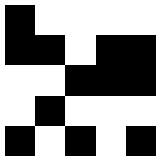

In [2]:
import matplotlib.pyplot as plt

def plot(C, ax=None):
    if ax is None:
        fig, ax = plt.subplots(dpi=50)
    ax.imshow(C, cmap="gray")
    ax.axis('off')
    
plot(C0)

En la siguiente función usamos un bucle en el que en cada iteración calcularemos el número de vecinos vivos para cada célula, y en función del número generamos una nueva cuadrícula con la siguiente generación.

In [3]:
def gol(C, MAX_IT):
    count = 0
    # iremos guardando aquí soluciones para luego hacer una animación
    Cs = [C]
    Ny, Nx = len(C), len(C[0])
    while count < MAX_IT:
        # generamos una nueva cuadrícula vacía
        C0 = [[0 for j in range(Nx)] for i in range(Ny)]
        # iteramos por cada célula
        for i in range(Ny):
            for j in range(Nx):
                # estado actual
                c = C[i][j]
                # numero vecinos
                v = C[i][j+1] + C[i][j-1] + C[i-1][j] + C[i+1][j] + \
                    C[i+1][j+1] + C[i+1][j-1] + C[i-1][j+1] + C[i-1][j-1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        # guardamos solución
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [4]:
C = init(20, 20)
Cs = gol(C, 10)

IndexError: ignored

¡Tenemos un problema! Nuestro algoritmo simple tiene un *bug*, y es que cuando intentamos acceder a los vecinos de algunas celdas, éstos no existen. Este problema lo tendremos en todas las celdas de las primeras y últimas filas y columnas. 

![](https://github.com/juansensio/blog/blob/master/067_gol/gol2.jpg?raw=1)

Para resolver este problema tendremos que usar *condicionales* para tener en cuenta estos casos especiales.

In [5]:
def gol(C, MAX_IT):
    count = 0
    Cs = [C]
    Ny, Nx = len(C), len(C[0])
    while count < MAX_IT:
        C0 = [[0 for j in range(Nx)] for i in range(Ny)]
        for i in range(Ny):
            for j in range(Nx):
                c = C[i][j]
                v = 0
                # la primer columna no tiene vecino a la izquierda
                if j > 0:
                    v += C[i][j-1]
                # la última columna no tiene vecino a la derecha
                if j < Nx - 1:
                    v += C[i][j+1]
                # la primer fila no tiene vecino arriba
                if i > 0:
                    v += C[i-1][j]
                    # la primer columna no tiene vecino a la izquierda
                    if j > 0:
                        v += C[i-1][j-1]
                    # la última columna no tiene vecino a la derecha
                    if j < Nx - 1:
                        v += C[i-1][j+1]
                # la útlima fila no tiene vecino abajo
                if i < Ny - 1:
                    v += C[i+1][j]
                    # la primer columna no tiene vecino a la izquierda
                    if j > 0:
                        v += C[i+1][j-1]
                    # la última columna no tiene vecino a la derecha
                    if j < Nx - 1:
                        v += C[i+1][j+1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [6]:
C = init(10, 10)
Cs = gol(C, 10)

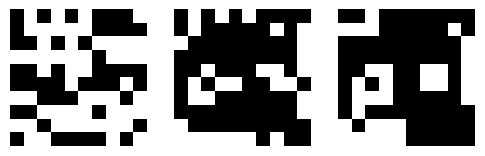

In [7]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1, 3, 1)
plot(Cs[0], ax)
ax = plt.subplot(1, 3, 2)
plot(Cs[1], ax)
ax = plt.subplot(1, 3, 3)
plot(Cs[2], ax)
plt.show()

Si bien nuestra implementación es correcta, no podemos decir que sea muy eficiente.

In [8]:
C = init(200, 200)
%time Cs = gol(C, 200)

CPU times: user 13.4 s, sys: 55.4 ms, total: 13.4 s
Wall time: 13.4 s


In [9]:
# animación

from matplotlib import animation, rc
rc('animation', html='html5')

def update(i):
    ax.clear()
    ax.imshow(Cs[i], cmap="gray")
    ax.axis('off')
    return ax

fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Intermedio

Tras varios meses programando, haciendo ejercicios y resolviendo problemas, vuelves a tu juego de la vida con algunas ideas en mente, y es que ahora sabes que puedes hacerlo mejor. Para ello decides *refactorizar* tu código para que sea más eficiente y simple. Podemos simplificar nuestro bucle eliminando todos los *ifs* si añadimos dos filas y columnas extra a nuestro mundo con células que siempre estarán a cero.

![](https://github.com/juansensio/blog/blob/master/067_gol/gol3.jpg?raw=1)

Ahora todas nuestras células tienen 8 vecinos, siempre y cuando empecemos y terminemos nuestros bucles una fila o columna hacia adentro.

In [10]:
def init(Nx, Ny):
    C = [[0 for j in range(Nx+2)] for i in range(Ny+2)]
    for i in range(1,Ny+1):
        for j in range(1,Nx+1):
            C[i][j] = random.randint(0,1)
    return C
    
init(3, 3)

[[0, 0, 0, 0, 0],
 [0, 0, 1, 1, 0],
 [0, 1, 0, 1, 0],
 [0, 0, 0, 1, 0],
 [0, 0, 0, 0, 0]]

In [11]:
def gol(C, MAX_IT):
    count = 0
    Cs = [C]
    Ny, Nx = len(C)-2, len(C[0])-2
    while count < MAX_IT:
        C0 = [[0 for j in range(Nx+2)] for i in range(Ny+2)]
        for i in range(1, Ny+1):
            for j in range(1, Nx+1):
                # estado actual
                c = C[i][j]
                # numero vecinos
                v = C[i][j+1] + C[i][j-1] + C[i-1][j] + C[i+1][j] + \
                    C[i+1][j+1] + C[i+1][j-1] + C[i-1][j+1] + C[i-1][j-1]
                # nuevo estado
                if c == 0 and v == 3:
                    C0[i][j] = 1
                elif c == 1 and (v == 2 or v == 3):
                    C0[i][j] = 1
                else:
                    C0[i][j] = 0
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [12]:
C = init(200, 200)
%time Cs = gol(C, 200)

CPU times: user 9.13 s, sys: 61 ms, total: 9.19 s
Wall time: 9.2 s


In [13]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Avanzado

Llevas varios años programando y conoces algunos trucos para hacer tu código más eficiente, por ejemplo ganando velocidad a cambio de consumir más memoria. En el caso del juego de la vida podemos pre-calcular una matriz que nos de, para cada célula, la posición de sus vecinos. Como esto no va a cambiar, podemos guardar el resultado y re-utilizarlo en nuestro bucle. Una vez tenemos esta matriz de vecinos, podemos calcular cuántos de ellos están vivos multiplicando esta matriz por el vector que representa nuestro mundo.

![](https://github.com/juansensio/blog/blob/master/067_gol/gol4.jpg?raw=1)

Lo primero que necesitamos es representar nuestro mundo como un *array*, en vez de una matriz. A la hora de visualizarlo, simplemente haremos un *reshape*.

In [14]:
import numpy as np

def init(Nx, Ny):
    C = np.random.randint(0, 2, (Ny*Nx,1))
    #C = np.ones((Ny*Nx,))
    return C

Ny, Nx = 3, 3
init(Ny, Nx)

array([[0],
       [1],
       [1],
       [0],
       [1],
       [1],
       [1],
       [0],
       [0]])

In [15]:
init(Ny, Nx).reshape(Ny, Nx)

array([[0, 0, 0],
       [0, 1, 1],
       [1, 0, 0]])

La matriz de vecinos tendrá tantas filas y columnas como células en nuestro mundo. En cada fila encontraremos los vecinos de cada célula, con un 1 indicando la posición de la célula vecina.

In [16]:
def vecinos(Nx, Ny):
    V = np.zeros((Ny*Nx, Ny*Nx))
    for j in range(Ny*Nx):
        if j > 0 and j % Nx:
            V[j][j-1] = 1
        if j < Ny*Nx - 1 and (j+1) % Nx:
            V[j][j+1] = 1
        if j >= Nx:
            V[j][j-Nx] = 1
            if (j+1) % Nx:
                V[j][j-Nx+1] = 1
            if j % Nx:
                V[j][j-Nx-1] = 1
        if j <= (Ny-1)*Nx - 1:
            V[j][j+Nx] = 1
            if j % Nx:
                V[j][j+Nx-1] = 1
            if (j+1) % Nx:
                V[j][j+Nx+1] = 1
    return V

Nx, Ny = 3, 3
vecinos(Nx, Ny)

array([[0., 1., 0., 1., 1., 0., 0., 0., 0.],
       [1., 0., 1., 1., 1., 1., 0., 0., 0.],
       [0., 1., 0., 0., 1., 1., 0., 0., 0.],
       [1., 1., 0., 0., 1., 0., 1., 1., 0.],
       [1., 1., 1., 1., 0., 1., 1., 1., 1.],
       [0., 1., 1., 0., 1., 0., 0., 1., 1.],
       [0., 0., 0., 1., 1., 0., 0., 1., 0.],
       [0., 0., 0., 1., 1., 1., 1., 0., 1.],
       [0., 0., 0., 0., 1., 1., 0., 1., 0.]])

In [17]:
C = init(Nx, Ny)
V = vecinos(Nx, Ny)

# multiplicando V por C, calcularemos el número de vecinos vivos de cada célula
N = V.dot(C)
N.reshape(Ny, Nx)

array([[1., 3., 2.],
       [1., 3., 3.],
       [1., 3., 2.]])

In [18]:
C.reshape(Ny, Nx)

array([[0, 0, 1],
       [0, 1, 1],
       [0, 0, 1]])

> Para asegurarte que el resultado es correcto, puedes inicializar un mundo con todas las células vivas. El resultado de `V.dot(C)` deberá dar el número de vecinos por cada célula, que será 8 siempre excepto en los casos especiales (3 en las esquinas y 5 en las primeras y últimas filas y columnas).

Ahora nuestro bucle se simplifica mucho. Podemos aprovechar la funcionalidad que nos ofrece `numpy` para el indexado a la hora de asignar los nuevos estados.  

In [19]:
def gol_np(C, V, MAX_IT):
    count = 0
    Cs = [C]
    while count < MAX_IT:
        # nuevo mundo a cero
        C0 = np.zeros(C.shape)
        # calcular vecinos vivos
        N = V.dot(C)
        # aplicamos regla 1
        C0[(C == 0) & (N == 3)] = 1
        # aplicamos regla 2
        C0[(C == 1) & ((N == 2) | (N == 3))] = 1
        # guardamos resultado para visualización
        Cs.append(C0)
        C = C0
        count += 1
    return Cs

In [ ]:
Nx, Ny = 200, 200

C = init(Nx, Ny)
V = vecinos(Nx, Ny)

In [ ]:
%time Cs = gol_np(C, V, 200)

In [ ]:
def update(i):
    ax.clear()
    ax.imshow(Cs[i].reshape((Ny,Nx)), cmap="gray")
    ax.axis('off')
    return ax

In [ ]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

Nuestra implementación es más inteligente y simple, sin embargo el gran tamaño de las matrices con las que trabajamos (que tiene dimensiones $N_x x N_x x N_y x N_y$) requiere de más tiempo para el cómputo. Tras un tiempo investigando como resolver el problema, llegas a la conclusión de que la mayor parte de los valores en la matriz de vecinos son 0, por lo que no solo estamos guardando muchísima información innecesaria si no que además nos podríamos ahorrar muchas operaciones, ya que sabemos que cualquier valor multiplicado por 0 es 0. Podemos conseguir nuestro objetivo si nuestra matriz de vecinos es de tipo *sparse*.

![](https://github.com/juansensio/blog/blob/master/067_gol/gol5.jpg?raw=1)

In [ ]:
from scipy.sparse import csr_matrix

def vecinos_sp(Nx, Ny):
    data, indices, indptr = [], [], [0]
    for i in range(Ny*Nx):
        if i > 0 and i % Nx:
            data.append(1)
            indices.append(i-1)
        if i < Ny*Nx - 1 and (i+1) % Nx:
            data.append(1)
            indices.append(i+1)
        if i >= Nx:
            data.append(1)
            indices.append(i-Nx)
            if (i+1) % Nx:
                data.append(1)
                indices.append(i-Nx+1)
            if i % Nx:
                data.append(1)
                indices.append(i-Nx-1)
        if i <= (Ny-1)*Nx - 1:
            data.append(1)
            indices.append(i+Nx)
            if i % Nx:
                data.append(1)
                indices.append(i+Nx-1)
            if (i+1) % Nx:
                data.append(1)
                indices.append(i+Nx+1)
        indptr.append(len(indices))
    return csr_matrix((data, indices, indptr))

Nx, Ny = 3, 3
vecinos_sp(Nx, Ny).toarray()

array([[0, 1, 0, 1, 1, 0, 0, 0, 0],
       [1, 0, 1, 1, 1, 1, 0, 0, 0],
       [0, 1, 0, 0, 1, 1, 0, 0, 0],
       [1, 1, 0, 0, 1, 0, 1, 1, 0],
       [1, 1, 1, 1, 0, 1, 1, 1, 1],
       [0, 1, 1, 0, 1, 0, 0, 1, 1],
       [0, 0, 0, 1, 1, 0, 0, 1, 0],
       [0, 0, 0, 1, 1, 1, 1, 0, 1],
       [0, 0, 0, 0, 1, 1, 0, 1, 0]])

In [ ]:
Nx, Ny = 200, 200

C = init(Nx, Ny)
V = vecinos_sp(Nx, Ny)

In [ ]:
%time Cs = gol_np(C, V, 200)

CPU times: user 125 ms, sys: 7.66 ms, total: 133 ms
Wall time: 132 ms


In [ ]:
def update(i):
    ax.clear()
    ax.imshow(Cs[i].reshape((Ny,Nx)), cmap="gray")
    ax.axis('off')
    return ax

fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

In [ ]:
Nx, Ny = 1000, 1000

C = init(Nx, Ny)
V = vecinos_sp(Nx, Ny)

In [ ]:
%time Cs = gol_np(C, V, 100)

CPU times: user 2.16 s, sys: 929 ms, total: 3.09 s
Wall time: 3.09 s


In [ ]:
fig = plt.figure(dpi=100)
ax = plt.subplot(1,1,1)
anim = animation.FuncAnimation(fig, update, frames=len(Cs), interval=100)
plt.close()

anim

## Bonus: Computación paralela

Podemos ir un paso más allá introduciendo la computación en paralelo. Para ello podemos dividir nuestra matriz y vectores y llevar a cabo las operaciones necesarias en las diferentes partes en diferentes núcleos o hilos de una misma CPU, múltiples CPUs e incluso GPUs. Dependiendo del tamaños de las matrices y la cantidad de datos que haya que comunicar entre procesos, podremos conseguir más o menos *speedup*. Puedes intentar implementar por ti mismo tal funcionalidad, aunque `numpy` ya lo hace de manera nativa. Para llevar a cabo estas operaciones en una GPU puedes usar librerías como `Pytorch` o `Numba`. Sin embargo, para el caso del juego de la vida la mayor eficiencia se obtiene con matrices *sparse* y este tipo de operaciones no tienen un gran soporte en GPU (al menos de momento, parece que en el futuro esto cambiará).

![](https://github.com/juansensio/blog/blob/master/067_gol/gol6.jpg?raw=1)

## Resumen

En este post hemos introducido el programa conocido como **juego de la vida**, simple pero a la vez muy útil para asentar conceptos básicos de programación. Hemos desarrollado este programa en varios niveles de dificultad y experiencia, desde cómo lo haría un programador que está aprendiendo hasta un experto en búsqueda de la máxima eficiencia. Durante el proceso hemos aprendido sobre estructuras de datos básicas en Python y operadores como bucles y condicionales. Hemos visto que podemos mejorar el algoritmo principal introduciendo matrices con `numpy` y como el formato de matriz *sparse* nos ayuda mucho ya que no necesitaremos malgastar memoria y cómputo con los valores que sean 0. Estos mismos conceptos se aplican en tareas más complicadas como el diseño de algoritmos de inteligencia artificial o la simulación de fluidos, en las que se usan los superordenadores más potentes del mundo y en las cuales la eficiencia es primordial.